In [102]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import metrics
from sklearn import preprocessing
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

In [39]:
%matplotlib inline

In [40]:
print (os.getcwd())

D:\projects\Detection of Parkinsons Disease


In [41]:
os.chdir ("D:\projects\Detection of Parkinsons Disease")

In [42]:
df=pd.read_csv('parkinsons.data')
display(df)

,name,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
0,phon_R01_S01_1,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,...,0.06545,0.02211,21.033,1,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,phon_R01_S01_2,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,...,0.09403,0.01929,19.085,1,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,phon_R01_S01_3,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,...,0.08270,0.01309,20.651,1,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,phon_R01_S01_4,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,...,0.08771,0.01353,20.644,1,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,phon_R01_S01_5,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,...,0.10470,0.01767,19.649,1,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,phon_R01_S50_2,174.188,230.978,94.261,0.00459,0.00003,0.00263,0.00259,0.00790,0.04087,...,0.07008,0.02764,19.517,0,0.448439,0.657899,-6.538586,0.121952,2.657476,0.133050
191,phon_R01_S50_3,209.516,253.017,89.488,0.00564,0.00003,0.00331,0.00292,0.00994,0.02751,...,0.04812,0.01810,19.147,0,0.431674,0.683244,-6.195325,0.129303,2.784312,0.168895
192,phon_R01_S50_4,174.688,240.005,74.287,0.01360,0.00008,0.00624,0.00564,0.01873,0.02308,...,0.03804,0.10715,17.883,0,0.407567,0.655683,-6.787197,0.158453,2.679772,0.131728
193,phon_R01_S50_5,198.764,396.961,74.904,0.00740,0.00004,0.00370,0.00390,0.01109,0.02296,...,0.03794,0.07223,19.020,0,0.451221,0.643956,-6.744577,0.207454,2.138608,0.123306


In [43]:
import pandas_profiling as pf

In [44]:
display(pf.ProfileReport(df))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [45]:
print(df.corr())

                  MDVP:Fo(Hz)  MDVP:Fhi(Hz)  MDVP:Flo(Hz)  MDVP:Jitter(%)  \
MDVP:Fo(Hz)          1.000000      0.400985      0.596546       -0.118003   
MDVP:Fhi(Hz)         0.400985      1.000000      0.084951        0.102086   
MDVP:Flo(Hz)         0.596546      0.084951      1.000000       -0.139919   
MDVP:Jitter(%)      -0.118003      0.102086     -0.139919        1.000000   
MDVP:Jitter(Abs)    -0.382027     -0.029198     -0.277815        0.935714   
MDVP:RAP            -0.076194      0.097177     -0.100519        0.990276   
MDVP:PPQ            -0.112165      0.091126     -0.095828        0.974256   
Jitter:DDP          -0.076213      0.097150     -0.100488        0.990276   
MDVP:Shimmer        -0.098374      0.002281     -0.144543        0.769063   
MDVP:Shimmer(dB)    -0.073742      0.043465     -0.119089        0.804289   
Shimmer:APQ3        -0.094717     -0.003743     -0.150747        0.746625   
Shimmer:APQ5        -0.070682     -0.009997     -0.101095        0.725561   

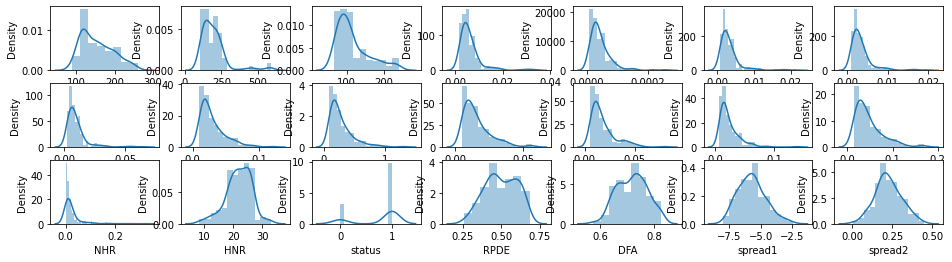

In [71]:
import warnings
warnings.filterwarnings('ignore')
rows=3
cols=7
index=1
fig, ax=plt.subplots(nrows=rows,ncols=cols,figsize=(16,4))
col=df.columns

for i in range(rows):
    for j in range(cols):
        sns.distplot(df[col[index]],ax=ax[i][j])
        index+=1

plt.show()

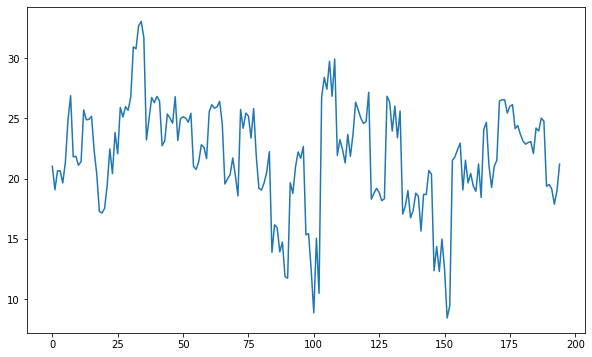

In [50]:
plt.figure(figsize=(10, 6))
plt.plot(df['HNR'])
plt.show()

In [58]:
quantile_transformer = preprocessing.QuantileTransformer(output_distribution='normal', random_state=0)

In [60]:
xtrain=df.drop(labels=['status','name'],axis=1)
xtrain= quantile_transformer.fit_transform(xtrain)
Xtrain

array([[-0.5724601 , -0.32885136, -1.42333462, ...,  0.58774863,
        -0.16876768,  0.99530565],
       [-0.42600652, -0.41190048,  0.41190048, ...,  1.2359024 ,
         0.38392919,  1.58308513],
       [-0.76663431, -0.85644338,  0.34252111, ...,  0.99530565,
        -0.06464883,  1.26412388],
       ...,
       [ 0.49789692,  0.97432155, -1.53938088, ..., -0.89435119,
         0.89435119, -0.78408593],
       [ 0.91379468,  1.63004123, -1.45985512, ..., -0.16876768,
        -0.52736788, -0.83794453],
       [ 1.32380742,  1.26412388, -1.06106625, ..., -0.44019785,
         0.55730423, -0.52736788]])

In [78]:
ytrain=df['status']
ytrain

0      1
1      1
2      1
3      1
4      1
      ..
190    0
191    0
192    0
193    0
194    0
Name: status, Length: 195, dtype: int64

In [87]:
X_train,X_val,y_train,y_val=train_test_split(xtrain,ytrain,test_size=0.25,random_state=42)

<AxesSubplot:>

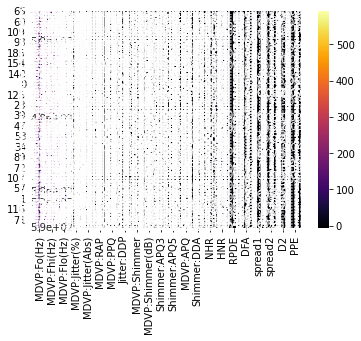

In [88]:
sns.heatmap(X_train,annot=True,cmap='inferno')

In [92]:

results = []


random_forest_params = [
    {'n_estimators': 100, 'max_depth': 5},
    {'n_estimators': 200, 'max_depth': 10},
    {'n_estimators': 500, 'max_depth': 20},
    
]

gradient_boosting_params = [
    {'n_estimators': 100, 'learning_rate': 0.1},
    {'n_estimators': 200, 'learning_rate': 0.05},
    {'n_estimators': 500, 'learning_rate': 0.01},
    
]

xgboost_params = {
    'n_estimators': 100,
    'learning_rate': 0.1,
    'max_depth': 5,
    
}

results = []

In [93]:
for params in random_forest_params:
    model = RandomForestClassifier(**params)
    model.fit(X_train, y_train)
    y_train_pred = model.predict(X_train)
    y_val_pred = model.predict(X_val)
    train_accuracy = accuracy_score(y_train, y_train_pred)
    val_accuracy = accuracy_score(y_val, y_val_pred)
    results.append({'Model': 'Random Forest', 'Hyperparameters': params, 'Train Accuracy': train_accuracy, 'Validation Accuracy': val_accuracy})

In [94]:
for params in gradient_boosting_params:
    model = GradientBoostingClassifier(**params)
    model.fit(X_train, y_train)
    y_train_pred = model.predict(X_train)
    y_val_pred = model.predict(X_val)
    train_accuracy = accuracy_score(y_train, y_train_pred)
    val_accuracy = accuracy_score(y_val, y_val_pred)
    results.append({'Model': 'Gradient Boosting', 'Hyperparameters': params, 'Train Accuracy': train_accuracy, 'Validation Accuracy': val_accuracy})

In [95]:
    
xgb_model = XGBClassifier(**xgboost_params)
xgb_model.fit(X_train, y_train)
y_train_pred = xgb_model.predict(X_train)
y_val_pred = xgb_model.predict(X_val)
train_accuracy = accuracy_score(y_train, y_train_pred)
val_accuracy = accuracy_score(y_val, y_val_pred)
results.append({'Model': 'XGBoost', 'Hyperparameters': xgboost_params, 'Train Accuracy': train_accuracy, 'Validation Accuracy': val_accuracy})

[12:54:31] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


Model: Random Forest
Hyperparameters: {'n_estimators': 100, 'max_depth': 5}
Train Accuracy: 1.0
Validation Accuracy: 0.9387755102040817

Classification Report Train is 
              precision    recall  f1-score   support

           0       1.00      0.64      0.78        11
           1       0.90      1.00      0.95        38

    accuracy                           0.92        49
   macro avg       0.95      0.82      0.86        49
weighted avg       0.93      0.92      0.91        49



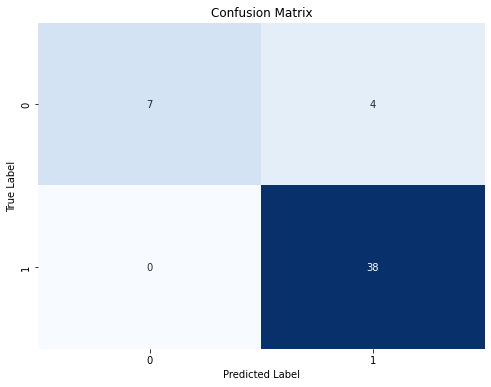


Model: Random Forest
Hyperparameters: {'n_estimators': 200, 'max_depth': 10}
Train Accuracy: 1.0
Validation Accuracy: 0.9183673469387755

Classification Report Train is 
              precision    recall  f1-score   support

           0       1.00      0.64      0.78        11
           1       0.90      1.00      0.95        38

    accuracy                           0.92        49
   macro avg       0.95      0.82      0.86        49
weighted avg       0.93      0.92      0.91        49



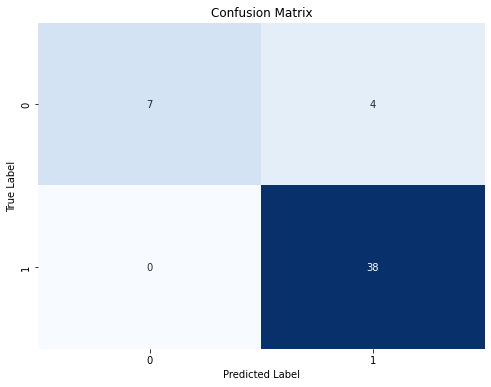


Model: Random Forest
Hyperparameters: {'n_estimators': 500, 'max_depth': 20}
Train Accuracy: 1.0
Validation Accuracy: 0.9387755102040817

Classification Report Train is 
              precision    recall  f1-score   support

           0       1.00      0.64      0.78        11
           1       0.90      1.00      0.95        38

    accuracy                           0.92        49
   macro avg       0.95      0.82      0.86        49
weighted avg       0.93      0.92      0.91        49



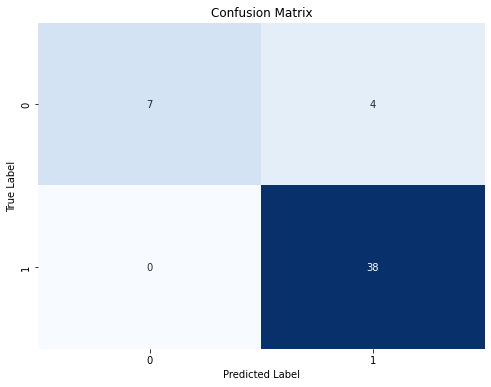


Model: Gradient Boosting
Hyperparameters: {'n_estimators': 100, 'learning_rate': 0.1}
Train Accuracy: 1.0
Validation Accuracy: 0.8979591836734694

Classification Report Train is 
              precision    recall  f1-score   support

           0       1.00      0.64      0.78        11
           1       0.90      1.00      0.95        38

    accuracy                           0.92        49
   macro avg       0.95      0.82      0.86        49
weighted avg       0.93      0.92      0.91        49



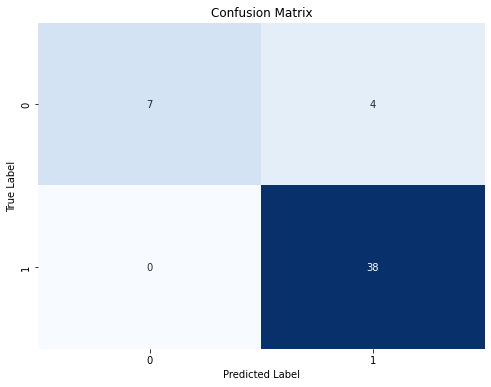


Model: Gradient Boosting
Hyperparameters: {'n_estimators': 200, 'learning_rate': 0.05}
Train Accuracy: 1.0
Validation Accuracy: 0.8979591836734694

Classification Report Train is 
              precision    recall  f1-score   support

           0       1.00      0.64      0.78        11
           1       0.90      1.00      0.95        38

    accuracy                           0.92        49
   macro avg       0.95      0.82      0.86        49
weighted avg       0.93      0.92      0.91        49



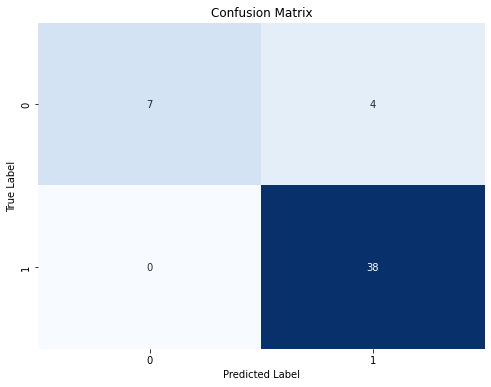


Model: Gradient Boosting
Hyperparameters: {'n_estimators': 500, 'learning_rate': 0.01}
Train Accuracy: 1.0
Validation Accuracy: 0.8979591836734694

Classification Report Train is 
              precision    recall  f1-score   support

           0       1.00      0.64      0.78        11
           1       0.90      1.00      0.95        38

    accuracy                           0.92        49
   macro avg       0.95      0.82      0.86        49
weighted avg       0.93      0.92      0.91        49



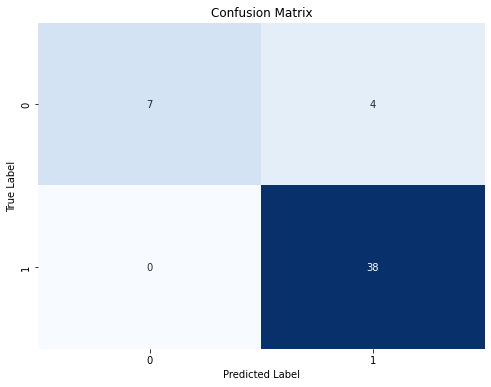


Model: XGBoost
Hyperparameters: {'n_estimators': 100, 'learning_rate': 0.1, 'max_depth': 5}
Train Accuracy: 1.0
Validation Accuracy: 0.9183673469387755

Classification Report Train is 
              precision    recall  f1-score   support

           0       1.00      0.64      0.78        11
           1       0.90      1.00      0.95        38

    accuracy                           0.92        49
   macro avg       0.95      0.82      0.86        49
weighted avg       0.93      0.92      0.91        49



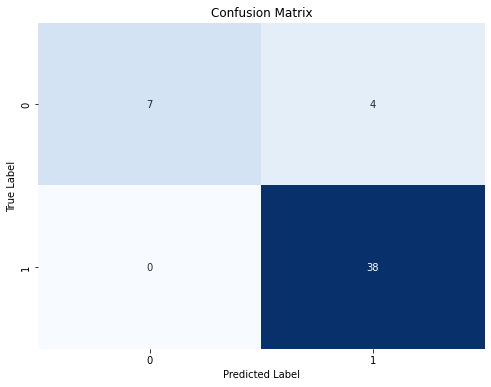

In [104]:
 import seaborn as sns


    
for result in results:
    print("Model:", result['Model'])
    print("Hyperparameters:", result['Hyperparameters'])
    print("Train Accuracy:", result['Train Accuracy'])
    print("Validation Accuracy:", result['Validation Accuracy'])
    print('\nClassification Report Train is ')
    print(classification_report (y_val,y_val_pred))
    cm = confusion_matrix(y_val, y_val_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False)
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()
    print()

In [119]:
model = RandomForestClassifier(n_estimators=100, max_depth= 5)
model.fit(X_train, y_train)
y_train_pred = model.predict(X_train)
y_val_pred = model.predict(X_val)
y_val_pred

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1,
       1, 1, 0, 1, 0], dtype=int64)

In [107]:
from sklearn.svm import SVC

clf = SVC(kernel='linear')
clf.fit(X_train,y_train)

SVC(kernel='linear')

[13:11:56] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Model accuracy on train is:  1.0
Model accuracy on test is:  0.9183673469387755


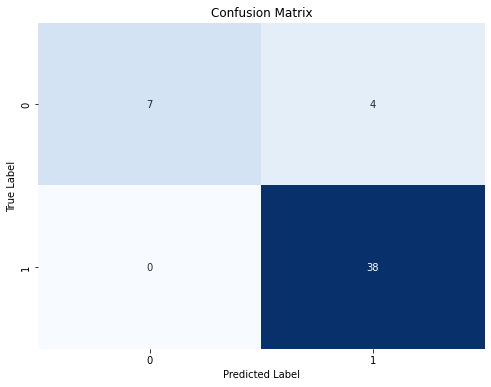


Classification Report
              precision    recall  f1-score   support

           0       1.00      0.64      0.78        11
           1       0.90      1.00      0.95        38

    accuracy                           0.92        49
   macro avg       0.95      0.82      0.86        49
weighted avg       0.93      0.92      0.91        49



In [115]:
xgb_model.fit(X_train, y_train)
y_train_pred = xgb_model.predict(X_train)
y_val_pred = xgb_model.predict(X_val)
train_accuracy = accuracy_score(y_train, y_train_pred)
val_accuracy = accuracy_score(y_val, y_val_pred)

print("Model accuracy on train is: ",train_accuracy)
print("Model accuracy on test is: ", val_accuracy)

cm = confusion_matrix(y_val, y_val_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False)
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()
print('\nClassification Report')
print(classification_report (y_val,y_val_pred))

In [120]:
import pickle 

pickle.dump(clf,open('deploy_SVM.pkl','wb'))
pickle.dump(model,open('deploy_RFC.pkl','wb'))

In [122]:
print("SVM")
model=pickle.load(open('deploy_SVM.pkl','rb'))
print (model.predict (X_train))
model=pickle.load(open('deploy_RFC.pkl','rb'))
print("Random Forest Classifier")
print (model.predict (X_train))

SVM
[0 1 1 1 1 1 1 0 1 0 1 0 1 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 1 1 1 1 0 1 1 1 1
 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1
 1 0 1 0 1 1 0 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 0 1 1 1 0 1 1 1 0
 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
Random Forest Classifier
[0 1 1 1 1 1 1 0 0 0 1 0 0 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 0 1 1 1 0 1 1 1 1
 1 1 1 0 1 1 1 1 1 0 1 1 1 0 1 1 1 0 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1
 1 0 1 0 1 1 0 1 1 1 0 1 0 1 1 0 1 0 1 1 1 1 0 0 1 1 1 1 0 1 1 1 0 1 1 1 0
 1 1 0 0 1 0 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 1 0 1 1 1 1 1 1]
